<a href="https://colab.research.google.com/github/budsayamasNithi/AI/blob/main/chapter_3_2_ANN_Day3_image_with_ANN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Classification
image classification using ANN by Dr.tanapon Tantisripreecha

Email: tanapon.tan@mahidol.ac.th

link: https://colab.research.google.com/drive/1kS55ZNVP_qHwxvidlzE5D-jCIHY-Y_Qs?usp=sharing


การสร้าง Classification โดยใช้ Machine learning กับรูปภาพ

# Import Libary

In [2]:
import numpy as np
import io
import pandas as pd
import matplotlib as pl
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt      # MATLAB like plotting routines
import random                        # for generating random numbers

from keras.models import Sequential  # Model type to be used

from keras.layers.core import Dense, Dropout, Activation # Types of layers to be used in our model
from keras.utils import np_utils

from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Conv2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, Flatten
#from keras.layers.normalization import BatchNormalization
from keras.layers.normalization import layer_normalization

# Loading dataset
การ Load image dataset เข้ามายัง colab จะสร้างข้อมูลใน Directory ดังต่อไปนี้

"/content/gdrive/My Drive/Colab Notebooks/dataset"

In [3]:
from google.colab import drive #case mounted gdrive
drive.mount('/content/gdrive', force_remount=False)


Mounted at /content/gdrive


In [6]:
import os  #case connect via OS
os.chdir("/content/gdrive/")
os.getcwd()

'/content/gdrive'

In [8]:
path = "/content/gdrive/MyDrive/Colab Notebooks/img_dataset"
files = os.listdir(path)

ตัวอย่างการแปลงรูปภาพให้เป็น array

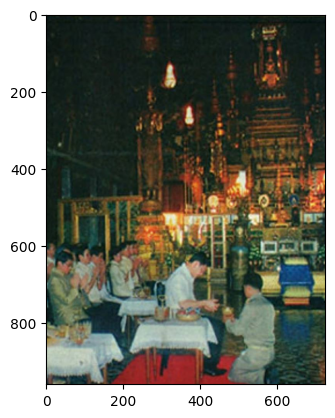

In [10]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img_test = mpimg.imread(path+"/"+'/tony woodsam1.jpg')
imgplot = plt.imshow(img_test)
plt.show()

In [11]:
pip install Keras-Preprocessing

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 1.9 MB/s eta 0:00:00


In [12]:
from keras_preprocessing.image import load_img
from tensorflow.keras.utils import img_to_array
from tensorflow.keras.utils import array_to_img


In [17]:
# example of converting an image with the Keras API


# load the image
img = load_img(path+"/"+'tony woodsam1.jpg',target_size=(100, 100))
print(type(img))
# convert to numpy array
img_arr = img_to_array(img)
#print type shape and the color  of pixel in array
print(img_arr.dtype)
print(img_arr.shape)
np.set_printoptions(threshold=np.inf) #Print NumPy array without truncation using set_printoptions() and threshold
print(img_arr)
# convert back to image
img_pil = array_to_img(img_arr)
print(type(img_pil))

#see RGB Compare  https://web.stanford.edu/class/cs101/image-1-introduction.html

Streaming output truncated to the last 5000 lines.
  [ 40.  24.   0.]
  [ 53.  48.  28.]
  [122.  66.  49.]
  [125.  57.  20.]
  [170.  66.  37.]
  [108.  47.  18.]
  [181. 107.  36.]
  [104.  80.  56.]
  [241. 212. 154.]
  [223. 181.  99.]
  [215. 209. 133.]
  [218. 150.  87.]
  [158.  60.  23.]
  [142.  55.  25.]
  [189. 138.  73.]
  [231. 182. 105.]
  [144.  68.  45.]
  [119.  55.  20.]
  [114.  72.  34.]
  [134.  95.  54.]
  [ 65.  47.  23.]
  [ 92.  72.  39.]
  [138.  81.  36.]
  [ 81.  46.  14.]
  [ 76.  65.  33.]
  [ 67.  59.  20.]
  [198. 179. 102.]
  [165. 130.  92.]
  [130. 122.  59.]
  [199. 147.  90.]
  [ 85.  61.  27.]
  [ 43.  51.  36.]
  [ 72.  50.  26.]
  [120.  63.  43.]
  [ 53.  37.  24.]
  [ 37.  51.  36.]
  [ 56.  78.  57.]
  [ 30.  56.  79.]
  [119. 118.  87.]
  [ 47.  60.  53.]
  [ 70.  62.  49.]
  [ 76.  42.  30.]
  [ 95.  46.  29.]
  [155.  60.  56.]
  [209. 117.  68.]
  [198.  58.  33.]
  [232. 108.  72.]
  [221. 103.  63.]
  [216. 156. 104.]
  [215. 144.  78.]

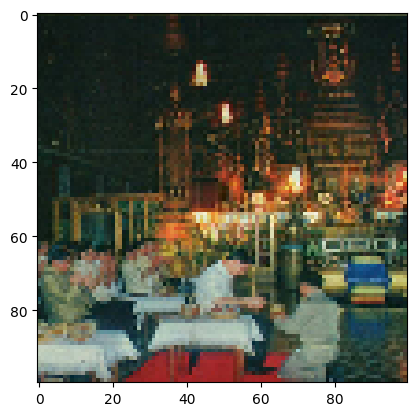

In [18]:
imgplot = plt.imshow(img_pil)
plt.show()

ทดลอง ลบไฟล์ beach.png ออกจาก folder ก่อนแล้วดึงชื่อ image file และ category ของแต่ละไฟล์

In [19]:
categories = []
# เก็บคลาส 'cetegories'

for filename in files:
    category = filename.split('.')[0]
    if 'fire' in category:
        categories.append("1") #fire = 1
    elif 'water' in category:
        categories.append("0") #water = 0
    else: pass
df = pd.DataFrame({
    'filename': files,
    'category': categories
})


In [20]:
print(df.head(16))

      filename category
0    fire1.png        1
1    fire2.png        1
2    fire3.png        1
3    fire4.png        1
4   water1.png        0
5   water2.png        0
6   water3.png        0
7   water4.png        0
8    fire5.png        1
9    fire6.png        1
10   fire7.png        1
11   fire8.png        1
12  water5.png        0
13  water6.png        0
14  water7.png        0
15  water8.png        0


แปลงไฟล์รูปภาพให้อยู่ในรูปแบบ numpy array แล้วเก็บไว้ในตัวแปร X และ category เก็บไว้ในตัวแปร y

In [24]:

#path = "/content/drive/MyDrive/Colab Notebooks/img_dataset"
#files = os.listdir(path)

X =  np.empty([0])
y = np.empty([0]) #คำเฉลย
for filename in files:
    print(path+"/"+filename)
    # load the image
    img = load_img(path+"/"+filename)

    #print(type(img))
    #print(img.format)
    #print(img.mode)
    print(img.size)
    img.show()


     # convert to numpy array
    img_array = img_to_array(img)

    X = np.append (X,img_array)
    category = filename.split('.')[0]
    if 'fire' in category:
        y = np.append(y,[1])
    elif 'water' in category:
        y = np.append(y,[0])
    else: pass

/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire1.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire2.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire3.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire4.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/water1.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/water2.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/water3.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/water4.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire5.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire6.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire7.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/fire8.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_dataset/water5.png
(120, 120)
/content/gdrive/MyDrive/Colab Notebooks/img_da

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [25]:
np.set_printoptions( )

In [26]:

X


array([  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   

In [27]:

print(y)

[1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0.]


In [28]:
X = X.reshape(len(y),120,120,3) #create 16 array list, new shape (120*120) , list ละ 3 แถว/มิติ R G B
x_vector = 120*120*3

In [30]:
X

array([[[[  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.

https://www.pluralsight.com/guides/importing-image-data-into-numpy-arrays

In [31]:
print(X.shape)
print(y.shape)
print(type(X))
print(type(y))

(16, 120, 120, 3)
(16,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


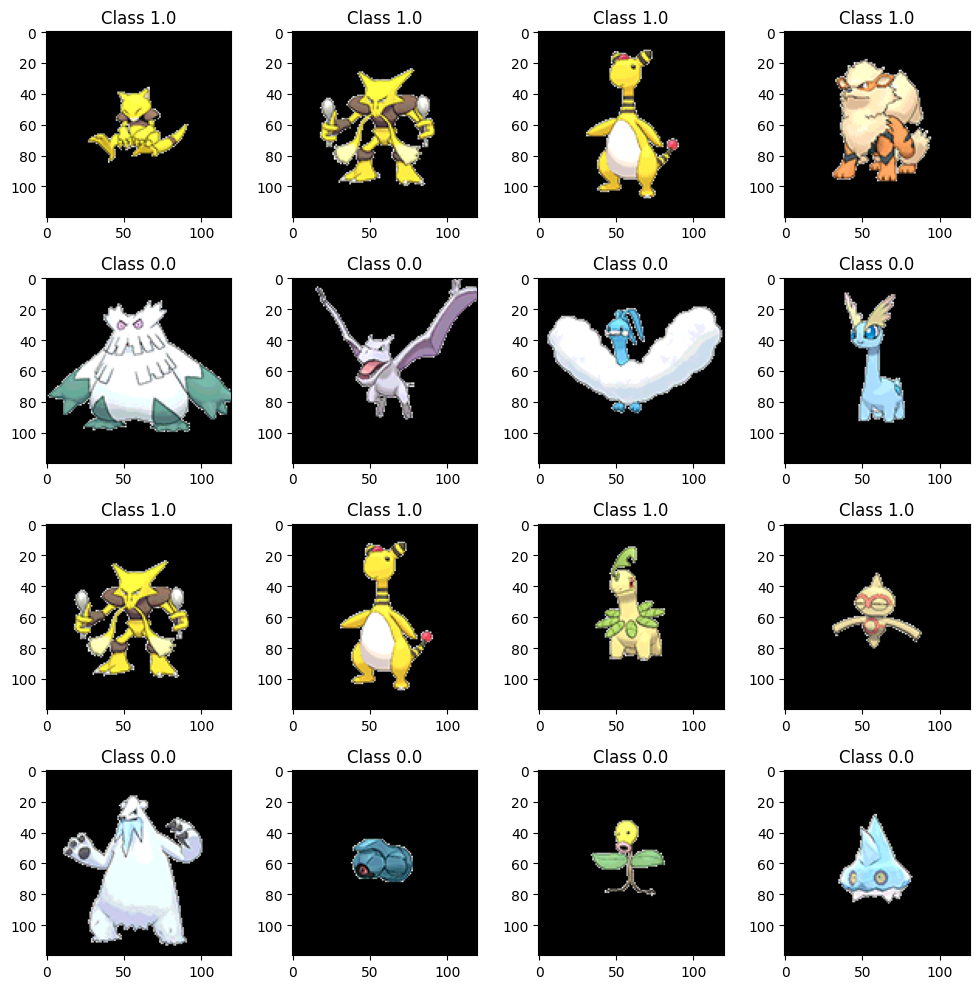

In [34]:
plt.rcParams['figure.figsize'] = (10,10) # change figure size to plot graph

for i in range(16):
    plt.subplot(4,4,i+1)
    img_array = X[i]
    plt.imshow(np.uint8(img_array)) #data type :  uint8 — unsigned integer (0 – 255)
    plt.title("Class {}".format(y[i]))

plt.tight_layout()

แบ่งข้อมูล train data และ test data

In [35]:
X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=0.2, random_state=1000)
print("X_train shape", X_train.shape)
print("y_train shape", y_train.shape)
print("X_test shape", X_test.shape)
print("y_test shape", y_test.shape)

print(type(X_train))
print(type(y_train))

len_train  = len(X_train)
len_test = len(X_test)

X_train shape (12, 120, 120, 3)
y_train shape (12,)
X_test shape (4, 120, 120, 3)
y_test shape (4,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [36]:
X_train

array([[[[  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.,   0.,   0.],
         [  0.

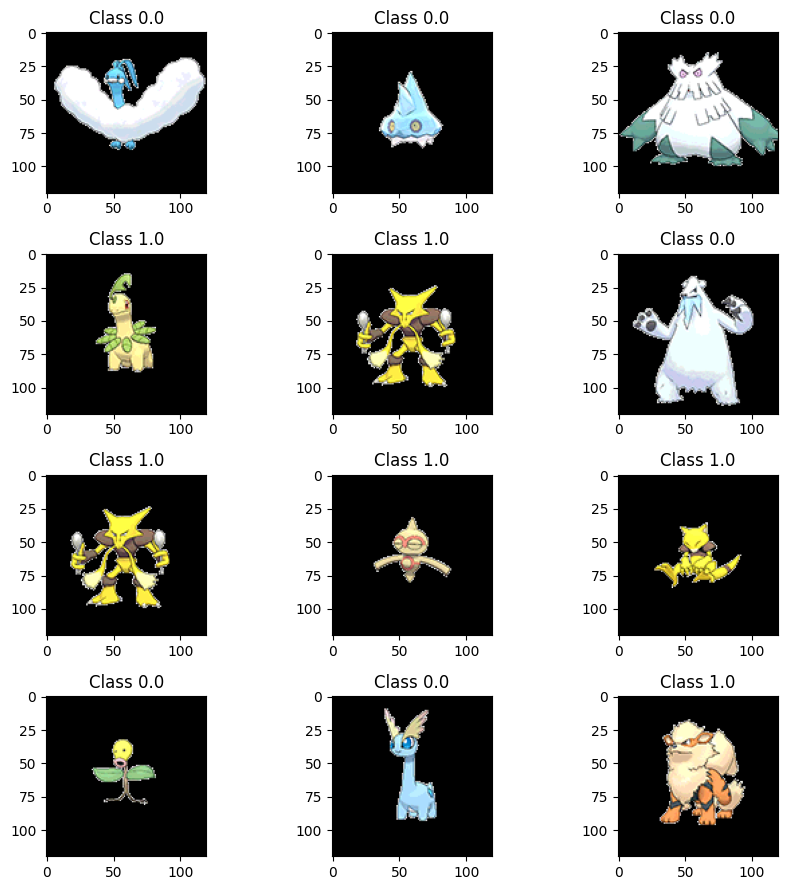

In [37]:

plt.rcParams['figure.figsize'] = (9,9) # change figure size to plot graph

for i in range(12):
    plt.subplot(4,3,i+1)
    img_array = X_train[i]
    plt.imshow(np.uint8(img_array))
    plt.title("Class {}".format(y_train[i]))

plt.tight_layout()

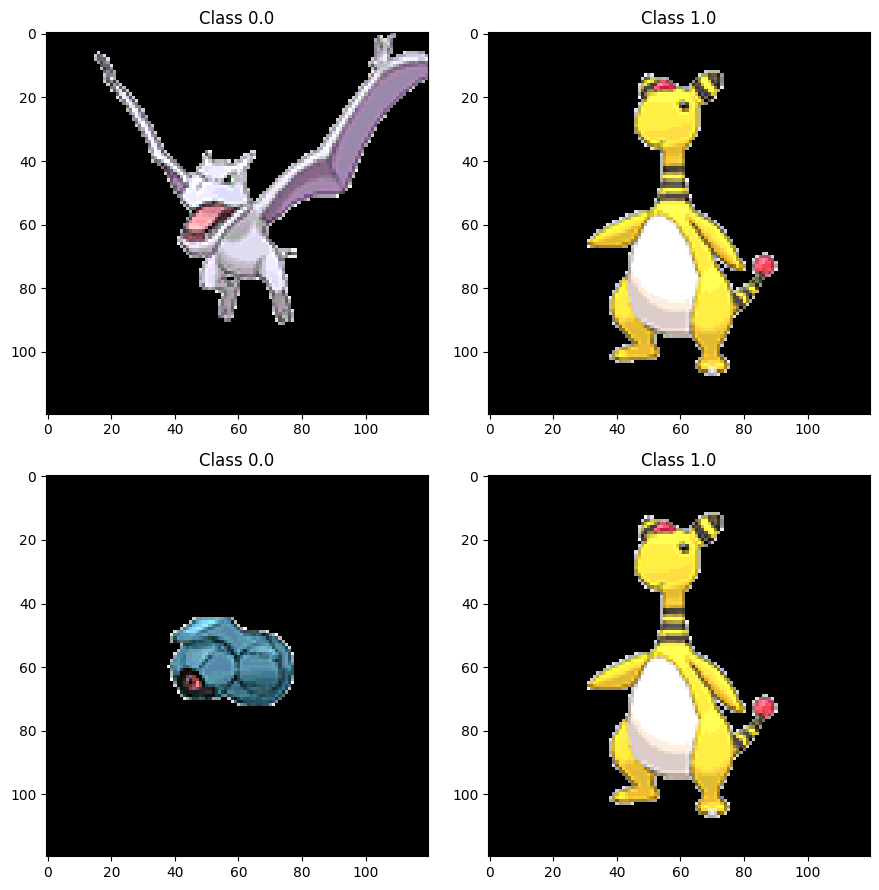

In [38]:
plt.rcParams['figure.figsize'] = (9,9) # change figure size to plot graph

for i in range(4):
    plt.subplot(2,2,i+1)
    img_array = X_test[i]
    plt.imshow(np.uint8(img_array))
    plt.title("Class {}".format(y_test[i]))

plt.tight_layout()

In [41]:
X_train = X_train.reshape(len_train, x_vector)  #x_vector 120*120*3
X_test = X_test.reshape(len_test, x_vector)

X_train = X_train.astype('float32')   # change integers to 32-bit floating point numbers
X_test = X_test.astype('float32')    # เปลี่ยนไทป์ float เป็น int

X_train /= 255
X_test /= 255  # it is good practice to normalize the pixel values so that each pixel value has a value between 0 and 1

print("Training matrix shape", X_train.shape)
print("Testing matrix shape", X_test.shape)

Training matrix shape (12, 43200)
Testing matrix shape (4, 43200)


In [40]:
X_train

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.  

In [42]:
nb_classes = 2 # number of unique digits

Y_train = np_utils.to_categorical(y_train, nb_classes) #Converts a class vector (integers) to binary class matrix.
Y_test = np_utils.to_categorical(y_test, nb_classes)
print("y_train shape", y_train.shape)
print("y_test shape", y_test.shape)

y_train shape (12,)
y_test shape (4,)


Prepare the test and train Data

#Neural Network using Tensorflow
กำหนดจำนวน class ที่ต้องการใน Y_train และ Y_test (Y ตัวใหญ่)
# Dropout
Drop out เป็น เทคนิคหนึ่งที่ช่วยแก้ปัญหาไม่ให้ model นั้นเกิดปัญหา Overfitting เกินไป

ดังนั้นจึงมีคนคิด เทคนิค Dropout มาช่วยแก้ปัญหานี้ขึ้น หลักการก็คือ ทำการ Random เพื่อที่จะ Drop node บาง node ที่อยู่ใน Neural Network(NN) เพื่อไม่ให้ node ใด node หนึ่งมีอิทธิพลมากเกินไป ก็คือ ช่วยๆ กัน เรียนรู้บ้าง โดยเราสามารถ ปรับได้ตั้งแต่ 0.1–1 ที่ไม่เอา 0 เพราะ ถ้า 0 คือ Drop ทิ้งหมดเลยแล้วจะเหลือใครทำงาน ?? ตัวอย่างเช่น ถ้าเรา Drop 60 % ก็คือ เหลือ Node ทำงานจริงๆ อยู่ 40%

Input layer


In [43]:
#Neural Network using Tensorflow
model = Sequential()
model.add(Dense(10, input_shape=(x_vector,)))
model.add(Activation('relu'))
model.add(Dropout(0.2))

Hidden Layer

In [44]:
model.add(Dense(10))
model.add(Activation('relu'))
model.add(Dropout(0.2))


Output Layer

In [45]:
model.add(Dense(2))
model.add(Activation('softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 10)                432010    
                                                                 
 activation (Activation)     (None, 10)                0         
                                                                 
 dropout (Dropout)           (None, 10)                0         
                                                                 
 dense_1 (Dense)             (None, 10)                110       
                                                                 
 activation_1 (Activation)   (None, 10)                0         
                                                                 
 dropout_1 (Dropout)         (None, 10)                0         
                                                                 
 dense_2 (Dense)             (None, 2)                 2

Complie model

In [46]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

Learning

In [47]:
history = model.fit(X_train, Y_train, batch_size=5, epochs=10, validation_data=(X_test, Y_test))

Epoch 1/10
3/3 [==============================] - 1s 87ms/step - loss: 0.6941 - accuracy: 0.4167 - val_loss: 0.6940 - val_accuracy: 0.2500
Epoch 2/10
3/3 [==============================] - 0s 20ms/step - loss: 0.6941 - accuracy: 0.4167 - val_loss: 0.6945 - val_accuracy: 0.2500
Epoch 3/10
3/3 [==============================] - 0s 15ms/step - loss: 0.6877 - accuracy: 0.8333 - val_loss: 0.6944 - val_accuracy: 0.5000
Epoch 4/10
3/3 [==============================] - 0s 16ms/step - loss: 0.6942 - accuracy: 0.5000 - val_loss: 0.6953 - val_accuracy: 0.5000
Epoch 5/10
3/3 [==============================] - 0s 15ms/step - loss: 0.6858 - accuracy: 0.6667 - val_loss: 0.6953 - val_accuracy: 0.5000
Epoch 6/10
3/3 [==============================] - 0s 16ms/step - loss: 0.6793 - accuracy: 0.5000 - val_loss: 0.6979 - val_accuracy: 0.5000
Epoch 7/10
3/3 [==============================] - 0s 15ms/step - loss: 0.6798 - accuracy: 0.5000 - val_loss: 0.7001 - val_accuracy: 0.5000
Epoch 8/10
3/3 [===========

Evaluation

In [48]:
score = model.evaluate(X_train, Y_train, verbose = 0)
print('Train loss : ', score[0])
print('Train accuracy : ', score[1])

Train loss :  0.6392717361450195
Train accuracy :  0.6666666865348816


In [49]:
score1 = model.evaluate(X_test, Y_test, verbose = 0)
print('Test loss : ', score1[0])
print('Test accuracy : ', score1[1])

Test loss :  0.7093238830566406
Test accuracy :  0.5


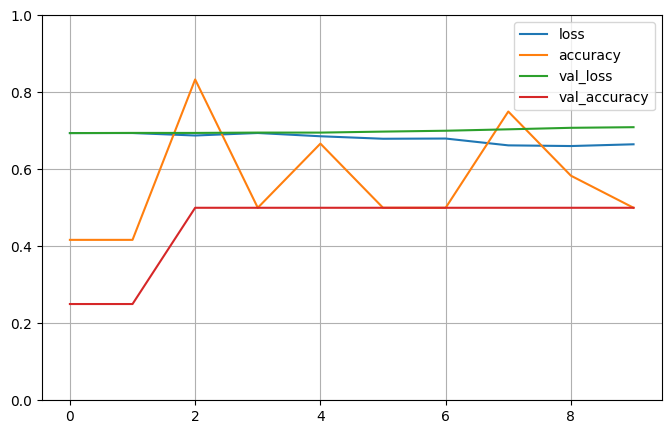

In [50]:
import pandas as pd
pd.DataFrame(history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [51]:
import keras
print(keras.backend.backend())
import tensorflow as tf
print(tf.__version__)

tensorflow
2.12.0


In [53]:
tf.keras.Sequential([model,tf.keras.layers.Softmax()])
result = model.predict(X_test)
for i in range(4):
  print(np.argmax(result[i]))

1/1 [==============================] - 0s 15ms/step
0
0
0
0


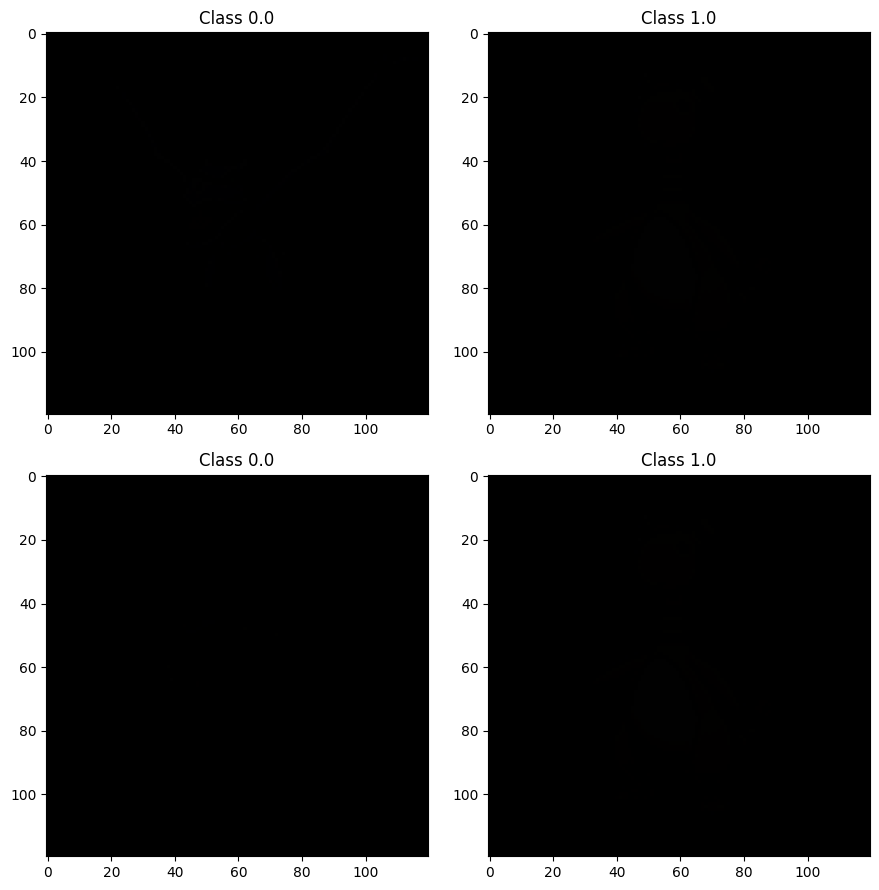

In [55]:
plt.rcParams['figure.figsize'] = (9,9) # change figure size to plot graph

for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(X_test[i].reshape(120,120,3))
    plt.title("Class {}".format(y_test[i]))
plt.tight_layout()

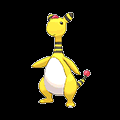

In [58]:
from tensorflow.keras.utils import array_to_img
image_show = array_to_img(X_test[1].reshape(120,120,3))
image_show

In [59]:
print(np.argmax(result[1])) #water = 0 , fire = 1

0
